<a href="https://colab.research.google.com/github/ShreyansJain04/ML_Induction/blob/main/UNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToTensor
from torchvision.utils import save_image
from PIL import Image
import os
from glob import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

In [ ]:
!pip install cloud-tpu-client==0.10 torch==2.0.0 torchvision==0.15.1 https://storage.googleapis.com/tpu-pytorch/wheels/colab/torch_xla-2.0-cp310-cp310-linux_x86_64.whl

In [ ]:
competition_name = "bulentsiyah/semantic-drone-dataset"

kaggle_creds_path = "/content/kaggle.json"

! pip install kaggle --quiet

! mkdir ~/.kaggle
! cp /content/kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

! kaggle datasets download -d {competition_name}

! mkdir kaggle_data




mkdir: cannot create directory ‘/root/.kaggle’: File exists
100% 3.88G/3.89G [02:08<00:00, 39.0MB/s]
100% 3.89G/3.89G [02:09<00:00, 32.4MB/s]
mkdir: cannot create directory ‘kaggle_data’: File exists
unzip:  cannot find or open bulentsiyah/semantic-drone-dataset.zip, bulentsiyah/semantic-drone-dataset.zip.zip or bulentsiyah/semantic-drone-dataset.zip.ZIP.


In [ ]:
! unzip semantic-drone-dataset.zip -d kaggle_data


  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/500.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/501.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/502.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/507.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/508.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/509.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/510.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/512.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/513.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/514.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/515.jpg  
  inflating: kaggle_data/dataset/semantic_drone_dataset/original_images/517.jpg  
  inflating: ka

In [ ]:
class Dataset(torch.utils.data.Dataset):

      def __init__(
          self,
          transform = None,
          classes = None,
          augmentation = None
          ):
        self.imgpath_list = sorted(glob('/content/kaggle_data/dataset/semantic_drone_dataset/original_images/*.jpg'))

        self.labelpath_list = sorted(glob('/content/kaggle_data/dataset/semantic_drone_dataset/label_images_semantic/*.png'))

      def __getitem__(self, i):

        imgpath = self.imgpath_list[i]
        img = cv2.imread(imgpath)
        img = cv2.resize(img, dsize = (256, 256))
        img = img / 255
        img = torch.from_numpy(img.astype(np.float32)).clone()
        img = img.permute(2, 0, 1)

        labelpath = self.labelpath_list[i]
        label = Image.open(labelpath)
        label = np.asarray(label)
        label = cv2.resize(label, dsize = (256, 256))
        label = torch.from_numpy(label.astype(np.float32)).clone()
        label = torch.nn.functional.one_hot(label.long(), num_classes = 24)
        label = label.to(torch.float32)
        label = label.permute(2, 0, 1)

        data = {"img": img, "label": label}
        return data

      def __len__(self):
            return len(self.imgpath_list)

In [ ]:
dataset = Dataset()


In [ ]:
len(dataset)

400

In [ ]:
train, val, test = torch.utils.data.random_split(dataset=dataset, lengths=[320, 40, 40], generator=torch.Generator().manual_seed(42))


In [ ]:
batch_size = 16

train_loader = torch.utils.data.DataLoader(train, batch_size, shuffle = True, drop_last = True)
val_loader = torch.utils.data.DataLoader(val, batch_size)
test_loader = torch.utils.data.DataLoader(test, batch_size)

In [ ]:
import torch
import torch.nn as nn

class UNet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UNet, self).__init__()

        # Encoder
        self.encoder_conv1 = self.conv_block(in_channels, 64)
        self.encoder_pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder_conv2 = self.conv_block(64, 128)
        self.encoder_pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder_conv3 = self.conv_block(128, 256)
        self.encoder_pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder_conv4 = self.conv_block(256, 512)
        self.encoder_pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Bottleneck
        self.bottleneck_conv = self.conv_block(512, 1024)

        # Decoder
        self.decoder_upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder_conv4 = self.conv_block(1024, 512)
        self.decoder_upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder_conv3 = self.conv_block(512, 256)
        self.decoder_upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder_conv2 = self.conv_block(256, 128)
        self.decoder_upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder_conv1 = self.conv_block(128, 64)

        # Output layer
        self.output_conv = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        # Encoder
        encoder1 = self.encoder_conv1(x)
        encoder2 = self.encoder_conv2(self.encoder_pool1(encoder1))
        encoder3 = self.encoder_conv3(self.encoder_pool2(encoder2))
        encoder4 = self.encoder_conv4(self.encoder_pool3(encoder3))

        # Bottleneck
        bottleneck = self.bottleneck_conv(self.encoder_pool4(encoder4))

        # Decoder
        decoder4 = self.decoder_upconv4(bottleneck)
        decoder4 = torch.cat((encoder4, decoder4), dim=1)
        decoder4 = self.decoder_conv4(decoder4)
        decoder3 = self.decoder_upconv3(decoder4)
        decoder3 = torch.cat((encoder3, decoder3), dim=1)
        decoder3 = self.decoder_conv3(decoder3)
        decoder2 = self.decoder_upconv2(decoder3)
        decoder2 = torch.cat((encoder2, decoder2), dim=1)
        decoder2 = self.decoder_conv2(decoder2)
        decoder1 = self.decoder_upconv1(decoder2)
        decoder1 = torch.cat((encoder1, decoder1), dim=1)
        decoder1 = self.decoder_conv1(decoder1)

        # Output layer
        output = self.output_conv(decoder1)

        return output

    def conv_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )


In [ ]:
import torch
import torch.nn as nn



# Create an instance of the UNet model
in_channels = 3  # Number of input channels (e.g., RGB image)
out_channels = 24  # Number of output channels (e.g., number of classes)
unet_model = UNet(in_channels, out_channels)


# Print the model architecture
print(unet_model)

# Move the model to the device (e.g., GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
unet_model = unet_model.to(device)

# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(unet_model.parameters(), lr=0.001)




UNet(
  (encoder_conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (encoder_pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (encoder_conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (encoder_pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (encoder_conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (encoder_pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, 

In [ ]:
num_epochs = 11
best_loss = float('inf')
best_model_state_dict = None

for epoch in range(num_epochs):
    unet_model.train()
    total_loss = 0.0

    for i, sample in enumerate(train_loader):
        inputs = sample['img'].to(device)
        labels = sample['label'].to(device)
        optimizer.zero_grad()
        outputs = unet_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

        if (i + 1) % 10 == 0:
            print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{i+1}/{len(train_loader)}], Loss: {loss.item():.4f}")

    average_loss = total_loss / len(train_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Average Loss: {average_loss:.4f}")

    # Val
    unet_model.eval()
    total_val_loss = 0.0

    for i, val_sample in enumerate(val_loader):
        val_inputs = val_sample['img'].to(device)
        val_labels = val_sample['label'].to(device)
        val_outputs = unet_model(val_inputs)
        val_loss = criterion(val_outputs, val_labels)
        total_val_loss += val_loss.item()

    average_val_loss = total_val_loss / len(val_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Val Loss: {average_val_loss:.4f}")

    # Check if the current model has the best val loss
    if average_val_loss < best_loss:
        best_loss = average_val_loss
        best_model_state_dict = unet_model.state_dict()

# After training, you can use the best model state dict to load the best model
if best_model_state_dict is not None:
    unet_model.load_state_dict(best_model_state_dict)


Epoch [1/11], Batch [10/20], Loss: 3.0139
Epoch [1/11], Batch [20/20], Loss: 3.0768
Epoch [1/11], Average Loss: 7.0964
Epoch [1/11], Val Loss: 3.0682
Epoch [2/11], Batch [10/20], Loss: 2.9710
Epoch [2/11], Batch [20/20], Loss: 2.9966
Epoch [2/11], Average Loss: 3.1154
Epoch [2/11], Val Loss: 2.9520
Epoch [3/11], Batch [10/20], Loss: 2.7126
Epoch [3/11], Batch [20/20], Loss: 2.4821
Epoch [3/11], Average Loss: 2.6514
Epoch [3/11], Val Loss: 2.3012
Epoch [4/11], Batch [10/20], Loss: 2.1319
Epoch [4/11], Batch [20/20], Loss: 2.2377
Epoch [4/11], Average Loss: 2.1420
Epoch [4/11], Val Loss: 2.1180
Epoch [5/11], Batch [10/20], Loss: 2.1354
Epoch [5/11], Batch [20/20], Loss: 2.1550
Epoch [5/11], Average Loss: 2.0745
Epoch [5/11], Val Loss: 2.0722
Epoch [6/11], Batch [10/20], Loss: 1.8790
Epoch [6/11], Batch [20/20], Loss: 2.0351
Epoch [6/11], Average Loss: 2.0392
Epoch [6/11], Val Loss: 2.0161
Epoch [7/11], Batch [10/20], Loss: 1.9768
Epoch [7/11], Batch [20/20], Loss: 1.7772
Epoch [7/11], Av

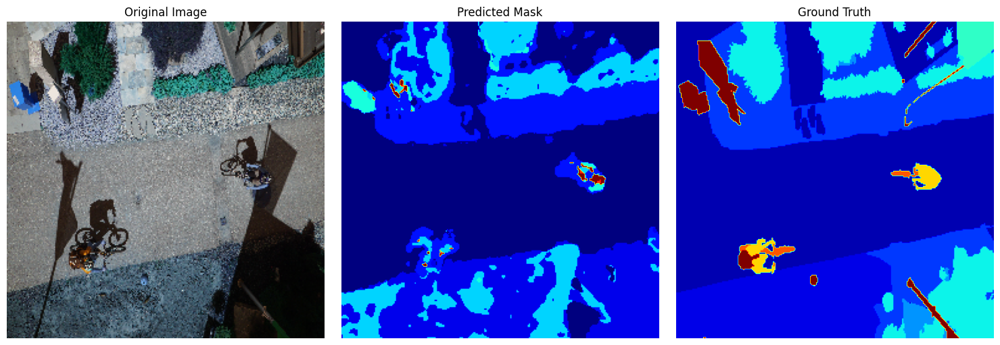

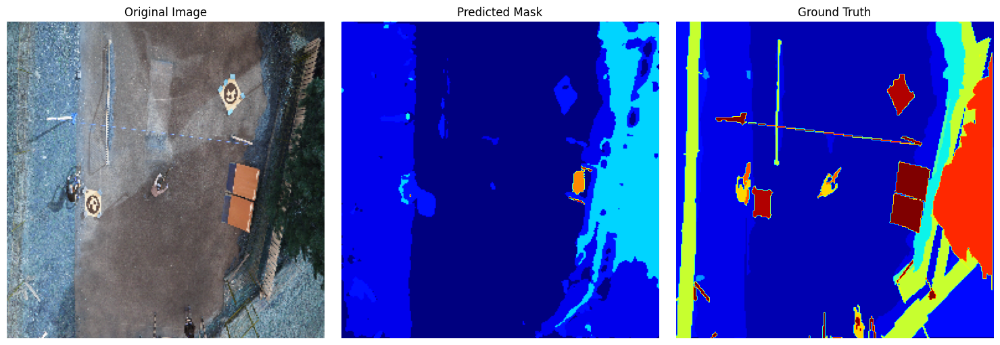

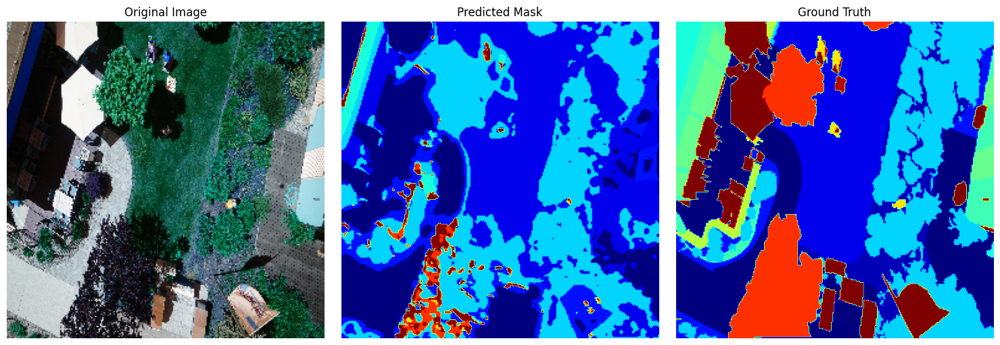

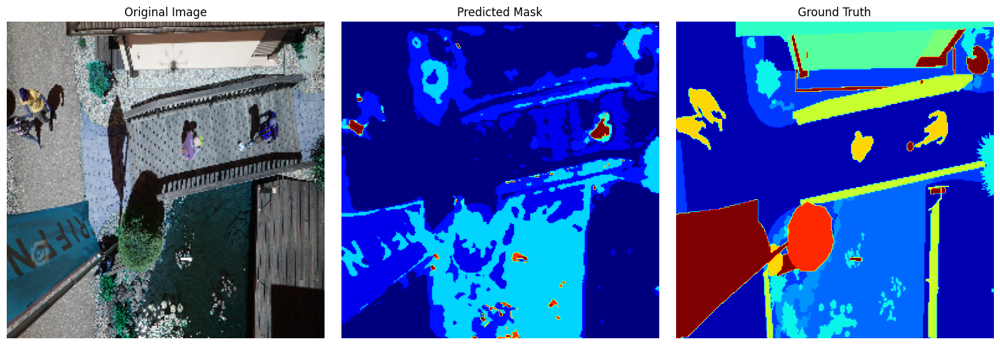

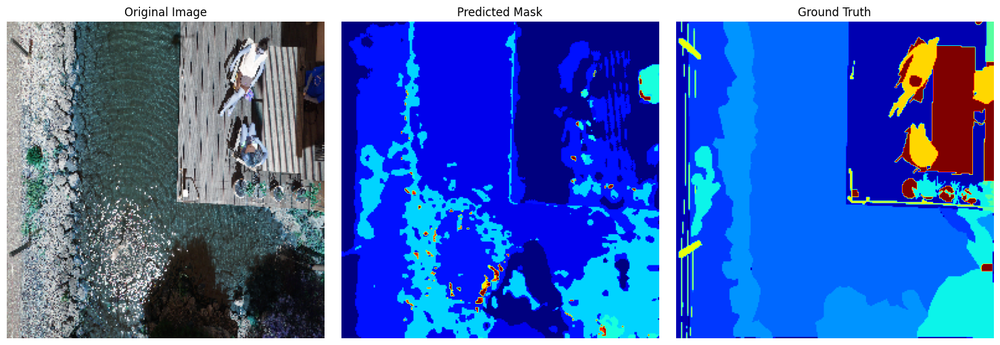

...

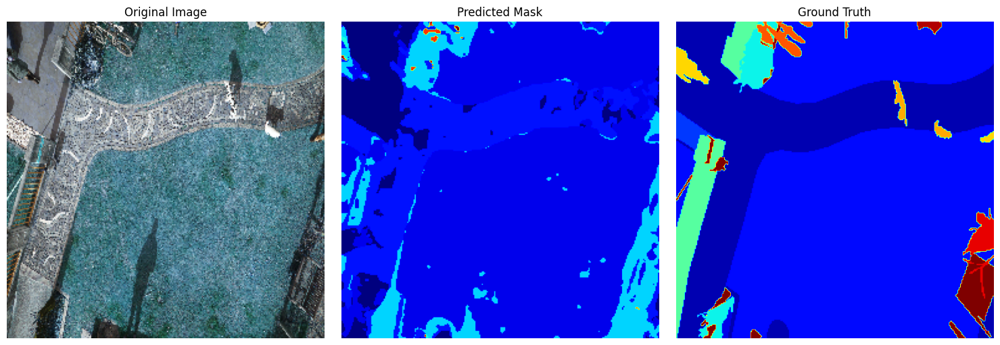

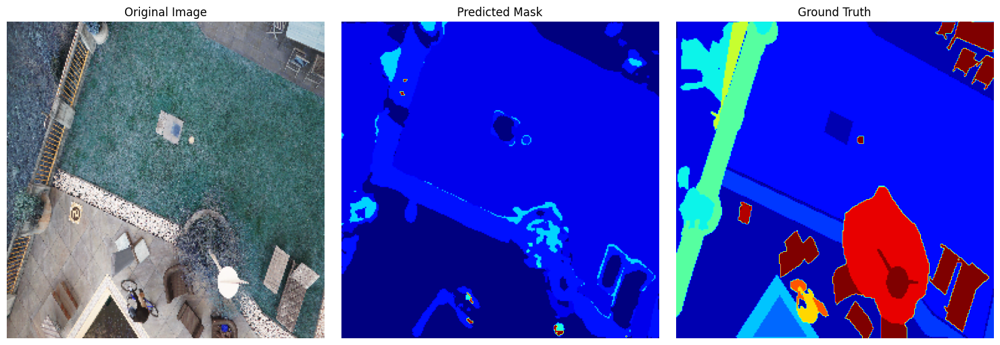

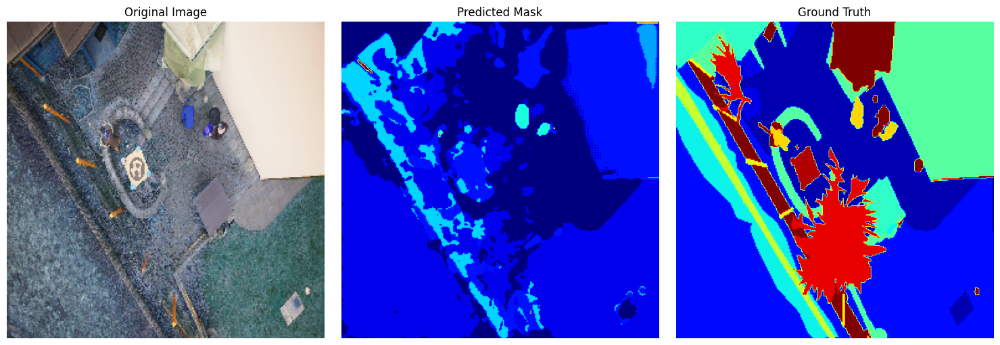

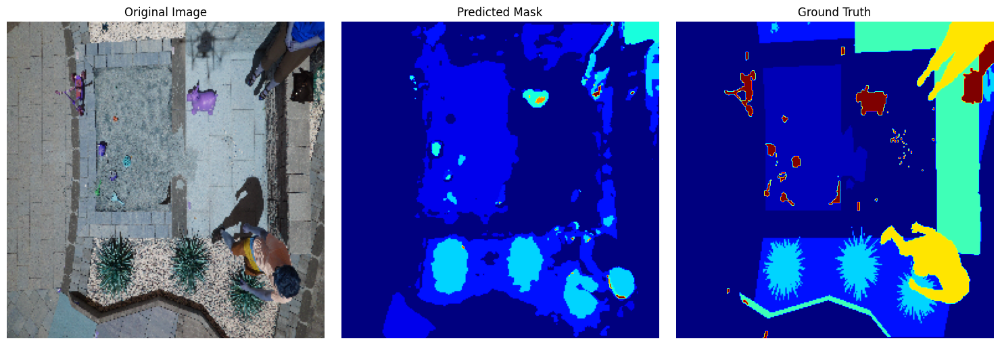

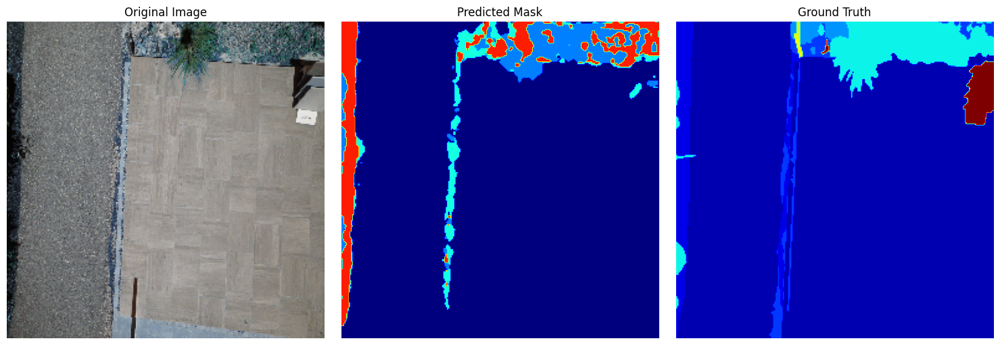

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

unet_model.eval()
with torch.no_grad():
    for i, sample in enumerate(test_loader):
        inputs = sample['img'].to(device)
        labels = sample['label'].to(device)

        # Forward pass
        outputs = unet_model(inputs)

        for j in range(inputs.shape[0]):  # Iterate over the batch dimension
            input_image = inputs[j].cpu().numpy()
            output_image = outputs[j].argmax(dim=0).cpu().numpy()  # Convert the predicted output to class indices
            label_image = labels[j].argmax(dim=0).cpu().numpy()  # Convert the ground truth labels to class indices

            input_image = np.transpose(input_image, (1, 2, 0))

            fig, axes = plt.subplots(1, 3, figsize=(15, 5))

            axes[0].imshow(input_image)
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            axes[1].imshow(output_image, cmap='jet')
            axes[1].set_title('Predicted Mask')
            axes[1].axis('off')

            axes[2].imshow(label_image, cmap='jet')
            axes[2].set_title('Ground Truth')
            axes[2].axis('off')

            plt.tight_layout()
            plt.show()


In [ ]:
def calculate_iou(output_image, input_image):
    intersection = np.logical_and(output_image, input_image)
    union = np.logical_or(output_image, input_image)
    iou_score = np.sum(intersection) / np.sum(union)
    print(iou_score)

def calculate_pixel_accuracy(output_image, input_image):
    correct_pixels = np.sum(output_image == input_image)
    total_pixels = output_image.size
    pixel_accuracy = correct_pixels / total_pixels
    print(pixel_accuracy)

def calculate_miou(output_images, input_images):
    miou_scores = []
    for i in range(len(output_images)):
        iou_score = calculate_iou(output_images[i], input_images[i])
        if iou_score is not None:  # Check for None values
            miou_scores.append(iou_score)
    if miou_scores:  # Check if miou_scores is not empty
        miou = np.mean(miou_scores)
        print(miou)
    else:
        print("No valid IoU scores found.")



In [ ]:
calculate_iou(output_image, label_image)
print("*"*50)
calculate_pixel_accuracy(output_image, label_image)
print("*"*50)
calculate_miou(output_image, label_image)


0.9997100830078125
**************************************************
0.8321990966796875
**************************************************
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
0.99609375
1.0
0.99609375
1.0
0.99609375
1.0
0.984375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
